
# SPMpy 
* Authors : Dr. Jewook Park at CNMS, ORNL
    * Center for Nanophase Materials Sciences (CNMS), Oak Ridge National Laboratory (ORNL)
    * email :  parkj1@ornl.gov
        
> **SPMpy** is a python package to analysis scanning probe microscopy (SPM) data analysis, such as scanning tunneling microscopy and spectroscopy (STM/S) data and atomic force microscopy (AFM) images, which are inherently multidimensional. SPMpy exploits recent image processing(a.k.a. Computer Vision) techniques, and utilzes [building blocks](https://scipy-lectures.org/intro/intro.html#the-scientific-python-ecosystem) and excellent visualization tools available in the [scientific python ecosystem](https://holoviz.org/index.html). Many parts are inspired by well-known SPM data analysis programs, for example, [Wsxm](http://www.wsxm.eu/) and [Gwyddion](http://gwyddion.net/). SPMpy is trying to apply lessons from [Fundamentals in Data Visualization](https://clauswilke.com/dataviz/).

>  **SPMpy** is an open-source project. (Github: https://github.com/jewook-park/SPMpy_ORNL )
> * Contributions, comments, ideas, and error reports are always welcome. Please use the Github page or email parkj1@ornl.gov. Comments & remarks should be in Korean or English. 

# Experimental Conditions 

## **Sample:<font color= White, font size="5" > $FeTe_{0.55}Se_{0.45}$ (old) </font>**
    * Cleaving: @ UHV Loadlock chamber, Room temp.
## **Tip: PtIr (from Unisoku)**
## Measurement temp: mK (40 mK)
* SC Tc  (FeTe0.55Se0.45 ) ≈ 14.5 K 
* STM Base Temperature : 40 mK 
* Estimated electron temperature ~ 230mK 
* PtIr Tip 


# <font color= orange > 0. Preparation  </font>

In [1]:
#############################
# check all necessary package
#############################

import glob
import os
from warnings import warn

import numpy as np
import pandas as pd
#install pandas 


try:
    from ipyfilechooser import FileChooser
except ModuleNotFoundError:
    warn("ModuleNotFoundError: No module named ipyfilechooser")
    from ipyfilechooser import FileChooser

try:
    import xrft
except ModuleNotFoundError:
    warn("ModuleNotFoundError: No module named xrft")
    !pip install xrft
    import xrft

In [2]:
########################################
#    * Step 1-1
#    : Import necessary packages
#        import modules
#########################################

import glob
import math
import os
from warnings import warn

import matplotlib.patches as patches
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy as sp
import seaborn as sns
import skimage
from scipy import signal
from SPMpy_2D_data_analysis_funcs import *
from SPMpy_3D_data_analysis_funcs import *

from SPMpy_fileloading_functions import (
    grid2xr,
    grid_line2xr,
    gwy_df_ch2xr,
    gwy_img2df,
    img2xr,
)




# some packages may be yet to be installed
try:
    from pptx import Presentation
except ModuleNotFoundError:
    warn("ModuleNotFoundError: No module named Presentation")
    !pip install python-pptx
    from pptx import Presentation
    from pptx.util import Inches, Pt

try:
    import nanonispy as nap
except ModuleNotFoundError:
    warn("ModuleNotFoundError: No module named nanonispy")
    !pip install nanonispy
    import nanonispy as nap

try:
    import seaborn_image as isns
except ModuleNotFoundError:
    warn("ModuleNotFoundError: No module named seaborn-image")
    #!pip install --upgrade scikit-image == 0.19.0.dev0
    !pip install --upgrade seaborn-image
    import seaborn_image as isns

try:
    import xarray as xr
except ModuleNotFoundError:
    warn("ModuleNotFoundError: No module named xarray")
    #!pip install --upgrade scikit-image == 0.19.0.dev0
    !pip install xarray
    import xarray as xr

try:
    import xrft
except ModuleNotFoundError:
    warn("ModuleNotFoundError: No module named xrft")
    !pip install xrft
    import xrft
    
    

try:
    import holoviews as hv
except ModuleNotFoundError:
    warn('ModuleNotFoundError: No module named holoviews')
    !pip install holoviews 
    import holoviews as hv

try:
    import seaborn_image as isns
except ModuleNotFoundError:
    warn('ModuleNotFoundError: No module named seaborn_image')
    !conda install -c conda-forge seaborn-image
    import seaborn_image as isns
    
    
    
try:
    import hvplot.xarray
    import hvplot.pandas 
except ModuleNotFoundError:
    warn('ModuleNotFoundError: No module named hvplot')
    !pip install hvplot
    import hvplot.xarray
    import hvplot.pandas 



try:
    import gwyfile
except ModuleNotFoundError:
    warn('ModuleNotFoundError: No module named gwyfile')
    !pip install gwyfile
    import gwyfile
 

# <font color= orange > 1. Choose Folder & DataFrame for analysis</font>

## 1-1. choose folder 


In [3]:
###########################################
# Create and display a FileChooser widget #
###########################################
file_chooser = FileChooser("")
display(file_chooser)

FileChooser(path='C:\Users\gkp\OneDrive - Oak Ridge National Laboratory\Research\Data Analysis (python)\SPMpy_…

In [ ]:
##############################
# After choose the folder    #
# Files DataFrame            #
##############################

folder_path = file_chooser.selected_path
print("folder_path = ", file_chooser.selected_path)
print("selected file name = ", file_chooser.selected_filename)
from SPMpy_fileloading_functions import files_in_folder

files_df = files_in_folder(folder_path)

### grid_xr  data structure 

* using grid2xr function
    * '_fb' : add fwd/bwd data average
    * grid_topo : 2D data
    * grid_3D : 3D data
    * I_fb : I, (forwad + backward sweep )/2
    * LIX_fb : LIX, (forwad + backward sweep )/2
    * dIdV : dI/dV (using xr differentiate class )
    * LIX_unit_calc : LIX_fb * LIX_coefficient (for unit calibration)
* after grid_3D_gap function
    * 2D data : CBM, VBM position assignment $\leftarrow$ based on I or LIX
        * CBM_I_mV, VBM_I_mV, gap_size_I, CBM_LIX_mV, VBM_LIX_mV, gap_size_LIX
    * 3D data : LDOS_fb $\leftarrow$ after unit calc & offset adjust
        * I_fb, LIX_fb, LDOS_fb, LDOS_fb_CB, LDOS_fb_VB
        * I_fb : I, (forwad + backward sweep )/2
        * LIX_fb : LIX, (forwad + backward sweep )/2
        * LDOS_fb : LIX_fb * LIX_coefficient (for unit calibration) + offset adjustment (according to LIX at I=0)
        * LDOS_fb_CB : based on LIX assignment
        * LDOS_fb_VB : based on LIX assignment

## 1-2. 3ds file loading to analyze

In [37]:
files_df[files_df.type=='3ds']#.file_name.iloc[0]
grid_xr = grid2xr(files_df[files_df.type=='3ds'].file_name.iloc[2])

Grid Spectroscopy X0.01F0.01_after10001_001
No Segments
Grid data acquired at bias = 0.002V
start from POS bias


In [38]:
grid_xr

<xarray.Dataset>
Dimensions:     (Y: 40, X: 80, bias_mV: 401)
Coordinates:
  * X           (X) float64 6.563e-08 6.688e-08 ... 1.631e-07 1.644e-07
  * Y           (Y) float64 2.106e-07 2.119e-07 ... 2.581e-07 2.594e-07
  * bias_mV     (bias_mV) float64 5.0 4.975 4.95 4.925 ... -4.95 -4.975 -5.0
Data variables:
    I_fwd       (Y, X, bias_mV) float64 1.154e-09 1.161e-09 ... -7.565e-10
    I_bwd       (Y, X, bias_mV) float64 1.276e-09 1.191e-09 ... -6.62e-10
    LIX_fwd     (Y, X, bias_mV) float64 1.313e-11 1.567e-11 ... 6.078e-12
    LIX_bwd     (Y, X, bias_mV) float64 1.324e-11 1.537e-11 ... 5.113e-12
    topography  (Y, X) >f4 -7.662e-08 -7.66e-08 ... -7.564e-08 -7.564e-08
Attributes:
    title:           Grid Spectroscopy X0.01F0.01_after10001_001.3ds (0.005 V...
    image_size:      [1e-07, 5e-08]
    X_spacing:       1.25e-09
    Y_spacing:       1.25e-09
    freq_X_spacing:  800000000.0
    freq_Y_spacing:  800000000.0

## 1-3. gap analysis (semiconductor)

In [39]:
grid_xr = grid_xr.assign_coords({'X': grid_xr.X -  grid_xr.X.min()})
grid_xr = grid_xr.assign_coords({'Y': grid_xr.Y -  grid_xr.Y.min()})

# grid data to xr 
grid_xr['I_fb'] = (grid_xr.I_fwd + grid_xr.I_fwd)/2
grid_xr['LIX_fb'] = (grid_xr.LIX_fwd + grid_xr.LIX_fwd)/2
# add 'I' & 'LIX' channel "fb = [fwb+bwd] / 2 " 

grid_topo = grid_xr[['topography']]
# topography 
grid_3D = grid_xr[['I_fb','LIX_fb']]
# averaged I & LIX 


grid_3D_gap = grid_3D_Gap(grid_3D)
# assign gap from STS
grid_3D_gap

<xarray.Dataset>
Dimensions:       (Y: 40, X: 80, bias_mV: 401)
Coordinates:
  * X             (X) float64 0.0 1.25e-09 2.5e-09 ... 9.75e-08 9.875e-08
  * Y             (Y) float64 0.0 1.25e-09 2.5e-09 ... 4.75e-08 4.875e-08
  * bias_mV       (bias_mV) float64 5.0 4.975 4.95 4.925 ... -4.95 -4.975 -5.0
Data variables:
    I_fb          (Y, X, bias_mV) float64 1.154e-09 1.161e-09 ... -7.565e-10
    LIX_fb        (Y, X, bias_mV) float64 1.313e-11 1.567e-11 ... 6.078e-12
    CBM_I_mV      (Y, X) float64 0.775 0.75 0.65 0.55 0.4 ... 0.4 0.4 0.425 0.4
    VBM_I_mV      (Y, X) float64 0.225 0.625 0.275 0.275 ... 0.4 -0.2 0.325
    gap_size_I    (Y, X) float64 0.55 0.125 0.375 0.275 ... 0.0 0.625 0.075
    LDOS_fb       (Y, X, bias_mV) float64 2.902e-10 3.462e-10 ... 1.345e-10
    CBM_LIX_mV    (Y, X) float64 0.725 0.6 0.6 0.225 ... 0.275 0.7 -0.05 0.125
    VBM_LIX_mV    (Y, X) float64 -0.175 -0.55 -0.45 -0.425 ... 0.7 -0.05 -0.025
    gap_size_LIX  (Y, X) float64 0.9 1.15 1.05 0.65 0.25 ... 0.3 0.0 0.0 0.15
    LDOS_fb_CB    (Y, X, bias_mV) float64 2.902e-10 3.462e-10 ... nan nan
    LDOS_fb_VB    (Y, X, bias_mV) float64 nan nan nan ... 1.681e-10 1.345e-10
Attributes:
    title:            Grid Spectroscopy X0.01F0.01_after10001_001.3ds (0.005 ...
    image_size:       [1e-07, 5e-08]
    X_spacing:        1.25e-09
    Y_spacing:        1.25e-09
    freq_X_spacing:   800000000.0
    freq_Y_spacing:   800000000.0
    I[A]_limit:       1e-13
    LDOS[A/V]_limit:  2.2064682315173816e-13

### 1.4 Topography view 

<Axes: >

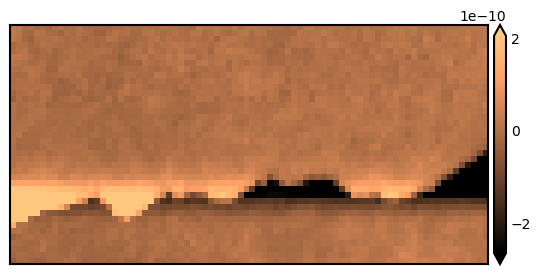

In [40]:
# show topography image
isns.imshow(plane_fit_y_xr(grid_topo).topography, robust =  True, cmap= 'copper', perc = (2,98))

# <font color= orange > 2. Visualization with Holoview </font>

## 2.choose the channel  & convert to holoview dataset 

* grid_3D_hv = hv.Dataset(grid_3D.LIX_fb)

## 2.1 Bias_mV slicing 

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
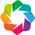

:DynamicMap   [bias_mV]
   :Image   [X,Y]   (LIX_fb)

In [41]:
grid_3D_hv = hv.Dataset(grid_3D.LIX_fb)
# convert xr dataset as a holoview dataset 
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')
###############
# bias_mV slicing
dmap_plane  = ["X","Y"]
dmap = grid_3D_hv.to(hv.Image,
                     kdims = dmap_plane,
                     dynamic = True )
dmap.opts(colorbar = True,
          cmap = 'bwr',
          frame_width = 400,
          aspect = 'equal').relabel('XY plane slicing: ')
fig = hv.render(dmap)
dmap   

##  2-2 Y or X slicing 

In [42]:
###############
# Y slicing
dmap_plane  = [ "X","bias_mV"]
dmap = grid_3D_hv.to(hv.Image,
                     kdims = dmap_plane,
                     dynamic = True )
dmap.opts(colorbar = True,
          cmap = 'bwr',
          frame_width = 400).relabel('X - bias_mV plane slicing: ')

:DynamicMap   [Y]
   :Image   [X,bias_mV]   (LIX_fb)

In [28]:

###############
# X slicing
dmap_plane  = ["bias_mV","Y"]
dmap = grid_3D_hv.to(hv.Image,
                     kdims = dmap_plane,
                     dynamic = True )
dmap.opts(colorbar = True,
          cmap = 'bwr',
          frame_width = 400).relabel('Y - bias_mV plane slicing: ')

:DynamicMap   [X]
   :Image   [bias_mV,Y]   (LIX_fb)

## 2-1. ROI (Ara) selection

### 2-1.1 Bound Box
* using Bounding Box 
* live 

### 2-1-1 bokeh plot & Bound box selection + get point selection

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
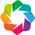

:DynamicMap   [bias_mV]
   :Overlay
      .Image.I                         :Image   [X,Y]   (I_fb)
      .Points.For_BBox_selection_colon :Points   [X,Y]   (I_fb)

In [43]:
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')

grid_channel_hv = hv.Dataset(grid_3D.I_fb)

# bias_mV slicing
dmap_plane  = ["X","Y"]
dmap = grid_channel_hv.to(hv.Image,
                          kdims = dmap_plane,
                          dynamic = True )
dmap.opts(colorbar = True,
          cmap = 'bwr',
          frame_width = 400,
          aspect = 'equal')#.relabel('XY plane slicing: ')

grid_channel_hv_image  = hv.Dataset(grid_3D.I_fb.isel(bias_mV = 0)).relabel('for BBox selection : ')

bbox_points = hv.Points(grid_channel_hv_image).opts(frame_width = 400,
                                                    color = 'k',
                                                    aspect = 'equal',
                                                    alpha = 0.1,                                   
                                                    tools=['box_select'])

bound_box = hv.streams.BoundsXY(source = bbox_points,
                                bounds=(0,0,0,0))
dmap*bbox_points


## hv.DynamicMap( 뒤에는 function 이 와야함), streams  로 해당 영역을 지정.( or 함수의 입력정보 지정) 
# averaged curve 를 그리기 위해서 해당영역을  xr  에서 average  해야함.. 
# curve 의 area 로 error bar도 같이 그릴것.. 

### 2-1-2 averaged STS of the selected Bound Box region


#### 2-1-2.1 draw 3 plots with isns

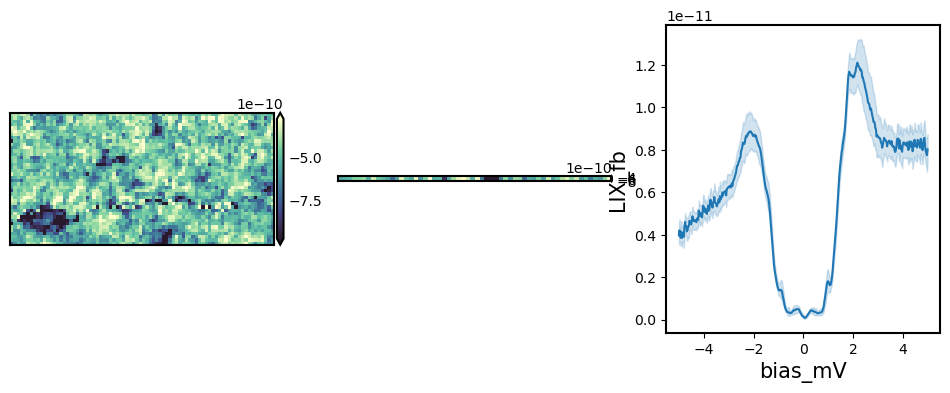

In [44]:
# slicing bias_mV = 5 mV
slicing_bias_mV = 5
#bound_box.bounds
x_bounds_msk = (grid_3D.X > bound_box.bounds[0] ) & (grid_3D.X < bound_box.bounds[2])
y_bounds_msk = (grid_3D.Y > bound_box.bounds[1] ) & (grid_3D.Y < bound_box.bounds[3])

grid_3D_bbox = grid_3D.where (grid_3D.X[x_bounds_msk] + grid_3D.Y[y_bounds_msk])

fig,axs = plt.subplots (nrows = 1,
                        ncols = 3,
                        figsize = (12,4))

isns.imshow(grid_3D.I_fb.isel(bias_mV = -50 ),
            ax =  axs[0],
            robust = True)
# add rectangle for bbox 

isns.imshow(grid_3D_bbox.I_fb.isel(bias_mV = -50 ),
            ax =  axs[1],
            robust = True)
sns.lineplot(x = "bias_mV",
             y = "LIX_fb", 
             data = grid_3D_bbox.to_dataframe(),
             ax = axs[2])
plt.savefig('grid011_bbox)p.png')
plt.show()

# plot STS at the selected points 
# use the seaborn (confident interval : 95%) 
# sns is figure-level function 

#### 2-1-2.2 draw 3 plots with hv plots  
* curve is not clear... 
* use the bounds as a mark. 


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
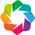

Invoked as load_subset(-4.999999888241291)


ValueError: cannot convert float NaN to integer

:Layout
   .DynamicMap.I  :DynamicMap   [bias_mV]
      :Overlay
         .Image.I  :Image   [X,Y]   (I_fb)
         .Bounds.I :Bounds   [x,y]
   .DynamicMap.II :DynamicMap   [bias_mV]
   .Curve.I       :Curve   [bias_mV]   (LIX_fb)

In [45]:
# bias_mV slicing
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')
#######################
# map with BBOX       #   
#######################

dmap_hv_wBbox = dmap.opts(frame_width = 200,)*hv.Bounds( bound_box.bounds ).opts(opts.Bounds(color='orange', line_width=6))



###########################
# BBOX separate plot      #   
###########################


grid_ch_bbox_hv = hv.Dataset(grid_3D_bbox.I_fb)
dmap_plane  = ["X","Y"]
dmap_bbox = grid_ch_bbox_hv.to(hv.Image,
                          kdims = dmap_plane,
                          dynamic = True, cmap = 'bwr')
# dmap size 
#frame_pixel_size =  10
#dmap_bbox#.opts(frame_width = len(grid_3D_bbox.X)*frame_pixel_size, frame_height = len(grid_3D_bbox.Y)*frame_pixel_size)


##########################
## bbox avg plot with hv #
##########################
grid_ch_bbox_mean = hv.Dataset(grid_3D_bbox.LIX_fb.mean(dim = ["X","Y"])).to(hv.Curve)
# simple plot 

dmap_hv_wBbox+dmap_bbox+ grid_ch_bbox_mean

In [53]:
def  grid_lineNpks_offset(xr_data_l_pks, 
                          ch_l_name = 'LIX_unit_calc',
                          plot_y_offset= 2E-11, 
                          peak_LIX_min = 1E-13, 
                          fig_size = (6,8), 
                          legend_title = None):
    # add peak point one-by-one (no palett func in sns)
    #  after find peak & padding
    # use choose the channel to offset-plot 
    # use the plot_y_offset to adjust the offset values 
    ch_l_name = ch_l_name
    ch_l_pk_name = ch_l_name +'_peaks_pad'
    line_direction = xr_data_l_pks.line_direction
    plot_y_offset  =  plot_y_offset
    
    sns_color_palette = "rocket"
    #color map for fig
    
    #xr_data_l_pks
    ### prepare XR dataframe for line spectroscopy plot 
    xr_data_l_pks_ch_slct = xr_data_l_pks[[ch_l_name,ch_l_pk_name]]
    # choose the 2 channels from 2nd derivative (to maintain the coords info) 


    #line_direction check again 
    
    if xr_data_l_pks.line_direction == 'Y': 
        spacing = xr_data_l_pks_ch_slct.Y_spacing
    elif xr_data_l_pks.line_direction == 'X': 
        spacing = xr_data_l_pks_ch_slct.X_spacing
    else : 
        print('check direction & X or Y spacing for offset') 

    xr_data_l_pks_ch_slct['offset'] = (xr_data_l_pks_ch_slct[line_direction] - xr_data_l_pks_ch_slct[line_direction].min())/spacing
    # prepare offset index channnel 
    print (' plot_y_offset  to adjust line-by-line spacing')

    xr_data_l_pks_ch_slct[ch_l_name+'_offset'] = xr_data_l_pks_ch_slct[ch_l_name] + plot_y_offset * xr_data_l_pks_ch_slct['offset']
    # offset the curve b
    print (xr_data_l_pks_ch_slct)
    

    ch_l_name_df_list = [] 
    ch_l_name_pks_df_list = []
    # prepare empty list to append dataframes in the for - loop (y_i or x_i)

    #line_direction check again 
    #########################
    # line_diection check
    if xr_data_l_pks_ch_slct.line_direction == 'Y': 
        lines  = xr_data_l_pks_ch_slct.Y

        for y_i, y_points in enumerate (lines):

            # set min peak height (LIX amplitude =  resolution limit)

            y_i_pks  = xr_data_l_pks_ch_slct[ch_l_pk_name].isel(Y = y_i).dropna(dim='peaks').astype('int32')
            # at (i_th )Y position, select peak index for bias_mV
            real_pks_mask = (xr_data_l_pks_ch_slct.isel(Y = y_i, bias_mV = y_i_pks.values)[ch_l_name] > peak_LIX_min).values
            # prepare a 'temp' mask for each Y position 
            y_i_pks_slct =  y_i_pks.where(real_pks_mask).dropna(dim='peaks').astype('int32')
            # y_i_pks_slct with mask selection  

            ch_l_name_y_i_df = xr_data_l_pks_ch_slct[ch_l_name+'_offset'].isel(Y = y_i).to_dataframe()
            # LIX_offset  at Y_i position 
            ch_l_name_df_list.append(ch_l_name_y_i_df)
            
            ch_l_name_y_i_pks_df = xr_data_l_pks_ch_slct.isel(Y = y_i, bias_mV = y_i_pks_slct.values)[ch_l_name+'_offset'].to_dataframe()
            # selected peaks with offest Y 
            ch_l_name_pks_df_list.append(ch_l_name_y_i_pks_df)
            
            # data at selected Y, & peak position, LIX_offset
            
    #########################
    # line_diection check

    elif xr_data_l_pks_ch_slct.line_direction == 'X': 
        lines = xr_data_l_pks_ch_slct.X

        for x_i, x_points in enumerate (lines):

            # set min peak height (LIX amplitude =  resolution limit)

            x_i_pks  = xr_data_l_pks_ch_slct[ch_l_pk_name].isel(X = x_i).dropna(dim='peaks').astype('int32')
            # at (i_th )X position, select peak index for bias_mV
            real_pks_mask = (xr_data_l_pks_ch_slct.isel(X = x_i, bias_mV = x_i_pks.values)[ch_l_name] > peak_LIX_min).values
            # prepare a 'temp' mask for each X position 
            x_i_pks_slct =  x_i_pks.where(real_pks_mask).dropna(dim='peaks').astype('int32')
            # x_i_pks_slct with mask selection  

            ch_l_name_x_i_df = xr_data_l_pks_ch_slct[ch_l_name+'_offset'].isel(X = x_i).to_dataframe()
            # LIX_offset  at X_i position 
            ch_l_name_df_list.append(ch_l_name_x_i_df)
            ch_l_name_x_i_pks_df = xr_data_l_pks_ch_slct.isel(X = x_i, bias_mV = x_i_pks_slct.values)[ch_l_name+'_offset'].to_dataframe()
            ch_l_name_pks_df_list.append(ch_l_name_x_i_pks_df)
            
            # selected peaks with offest X 
            
    else : 
        print('check direction & X or Y spacing for offset') 
    
    ch_l_name_df = pd.concat(ch_l_name_df_list).reset_index()
    ch_l_name_pks_df = pd.concat(ch_l_name_pks_df_list).reset_index()
    
    fig,ax = plt.subplots(figsize = fig_size)

    sns.lineplot(data = ch_l_name_df,
                         x ='bias_mV', 
                         y = ch_l_name+'_offset',
                         palette = "rocket",
                         hue = xr_data_l_pks.line_direction,
                         ax = ax)

    sns.scatterplot(data = ch_l_name_pks_df,
                            x ='bias_mV',
                            y = ch_l_name+'_offset',
                            palette ="rocket",
                            hue = xr_data_l_pks.line_direction,
                    s =0,
                            ax = ax)
    # legend control!( cut the handles 1/2)
    ax.set_xlabel('Bias (mV)')   
    #ax.set_ylabel(ch_l_name+'_offset')   
    ax.set_ylabel('LDOS')   
    handles0, labels0 = ax.get_legend_handles_labels()
    labels1 = [ str(float(label)*10) for label in labels0[:int(len(labels0)//2)] ] 
    # convert the line length as nm  
    ax.legend(handles0[:int(len(handles0)//2)],
              labels1, title = legend_title)
    # use the half of legends (line + scatter) --> use lines only
    #plt.show()
    ax.legend().remove()
    ax.set_xlim([-4,4])
    
    return xr_data_l_pks_ch_slct, ch_l_name_df, ch_l_name_pks_df, fig

In [54]:
grid_3D_bbox

<xarray.Dataset>
Dimensions:        (Y: 1, X: 58, bias_mV: 401)
Coordinates:
  * X              (X) float64 1.5e-08 1.625e-08 1.75e-08 ... 8.5e-08 8.625e-08
  * Y              (Y) float64 4.125e-08
  * bias_mV        (bias_mV) float64 5.0 4.975 4.95 4.925 ... -4.95 -4.975 -5.0
Data variables:
    I_fb           (Y, X, bias_mV) float64 6.457e-10 6.052e-10 ... -4.621e-10
    LIX_fb         (Y, X, bias_mV) float64 5.508e-12 4.829e-12 ... 2.48e-12
    dIdV           (Y, X, bias_mV) float64 1.623e-09 7.654e-10 ... 5.01e-10
    LIX_unit_calc  (Y, X, bias_mV) float64 1.215e-10 1.065e-10 ... 5.472e-11
Attributes:
    title:           Grid Spectroscopy X0.01F0.01_after10001_001.3ds (0.005 V...
    image_size:      [1e-07, 5e-08]
    X_spacing:       1.25e-09
    Y_spacing:       1.25e-09
    freq_X_spacing:  800000000.0
    freq_Y_spacing:  800000000.0

line_direction == X
Apply a Savitzky-Golay filter to an xarray Dataset.
3D data
3D data
3D data
3D data
Apply a Savitzky-Golay filter to an xarray Dataset.
3D data
3D data
3D data
3D data
Find peaks in STS to an xarray Dataset.
 plot_y_offset  to adjust line-by-line spacing
<xarray.Dataset>
Dimensions:                  (X: 58, bias_mV: 401, peaks: 66)
Coordinates:
  * X                        (X) float64 1.5e-08 1.625e-08 ... 8.5e-08 8.625e-08
  * bias_mV                  (bias_mV) float64 5.0 4.975 4.95 ... -4.975 -5.0
  * peaks                    (peaks) int32 0 1 2 3 4 5 6 ... 60 61 62 63 64 65
Data variables:
    LIX_unit_calc            (X, bias_mV) float64 1.215e-10 ... 5.472e-11
    LIX_unit_calc_peaks_pad  (X, peaks) float64 7.0 18.0 24.0 ... nan nan nan
    offset                   (X) float64 0.0 1.0 2.0 3.0 ... 54.0 55.0 56.0 57.0
    LIX_unit_calc_offset     (X, bias_mV) float64 1.215e-10 ... 1.195e-09
Attributes:
    title:           Grid Spectroscopy X0.01F0.01_after10001

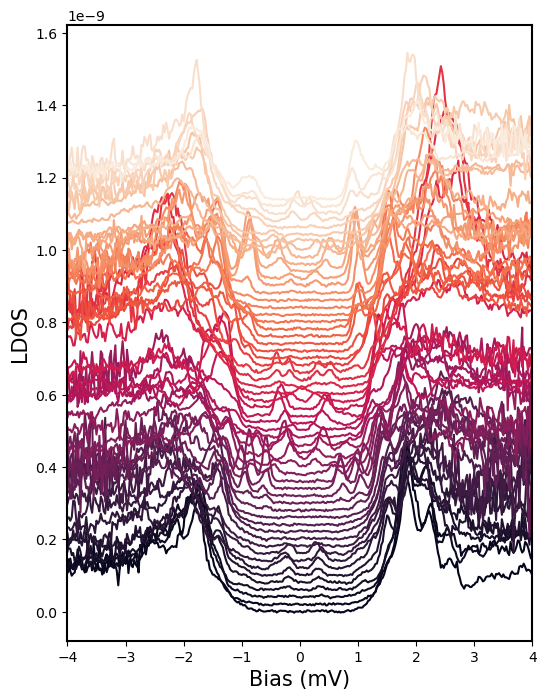

In [55]:
grid_3D_bbox_pk = grid3D_line_avg_pks (grid_3D_bbox,average_in= 'Y', ch_l_name= 'LIX_fb')
#grid_3D_crop_pk
xr_data_l_pks_ch_slct, ch_l_name_df, ch_l_name_pks_df, fig = grid_lineNpks_offset(grid_3D_bbox_pk,peak_LIX_min=2E-14,plot_y_offset=2E-11)


fig.savefig('grid0015_001_l_pf.png')

### 2-2-1 bokeh plot & Lasso Selection + get point_lists

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
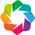

:DynamicMap   [bias_mV]
   :Overlay
      .Image.I   :Image   [X,Y]   (I_fb)
      .Dataset.I :Dataset   [X,Y]   (I_fb)
      .Points.I  :Points   [X,Y]   (I_fb)

In [32]:
hv.extension('bokeh')


grid_channel_hv = hv.Dataset(grid_3D.I_fb)

# bias_mV slicing
dmap_plane  = ["X","Y"]
dmap = grid_channel_hv.to(hv.Image,
                          kdims = dmap_plane,
                          dynamic = True )
dmap.opts(colorbar = True,
          cmap = 'bwr',
          frame_width = 400,
          aspect = 'equal').relabel('XY plane slicing: ')



grid_channel_hv_image = hv.Dataset(grid_3D.I_fb.isel(bias_mV = 0))

grid_channel_hv_points = hv.Points(grid_channel_hv_image).opts(frame_width = 400,  
                                   aspect = 'equal', alpha = 0.1,                                   
                                   tools=['box_select', 'lasso_select']
                                  )

slct_pts = hv.streams.Selection1D(source=grid_channel_hv_points)

dmap*grid_channel_hv_image*grid_channel_hv_points

<function matplotlib.pyplot.show(close=None, block=None)>

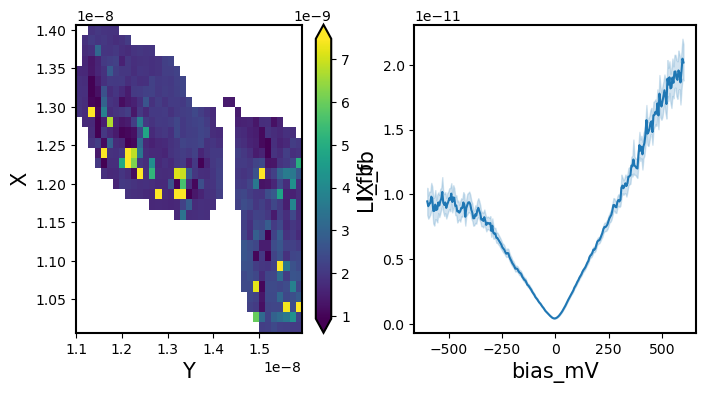

In [33]:
#slct_pts
pts = grid_channel_hv_points.iloc[slct_pts.index].dframe().set_index(['X', 'Y'])

pts_xr = xr.Dataset.from_dataframe(pts)

grid_3D_slct_pts = xr.combine_by_coords ([grid_3D, pts_xr], compat = 'override', join = 'inner')
#y_pts = points.iloc[slct_pts.index].dframe().Y
#grid_3D.sel(X = x_pts,Y = y_pts)
#grid_3D.I_fb.isel(bias_mV = 0).plot()

fig, axs = plt.subplots(ncols = 2, nrows = 1, figsize = (8,4))

grid_3D_slct_pts.I_fb.plot(ax = axs[0], robust = True) 

sns.lineplot(x = "bias_mV",            
             y = "LIX_fb", 
             data = grid_3D_slct_pts.to_dataframe(),
             ax = axs[1])
plt.show
#grid_3D_slct_pts
#
#sns.relplot(x="bias_mV",
#            y="LIX_fb", 
#            kind="line",
#            data=grid_3D_slct_pts.to_dataframe())
# check. sn.relplot is  figure-level function

### Lasso selected points

<function matplotlib.pyplot.show(close=None, block=None)>

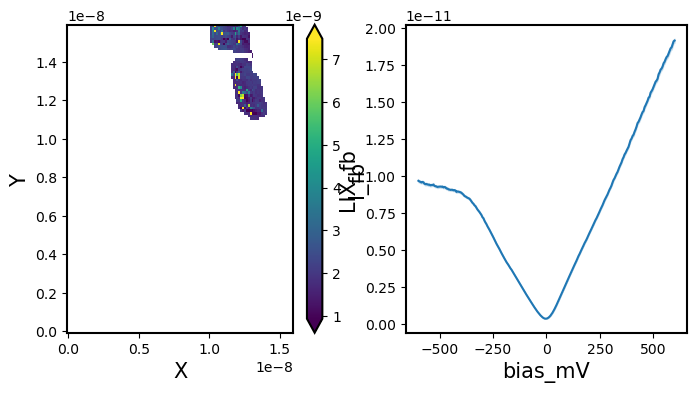

In [34]:
#slct_pts
pts = grid_channel_hv_points.iloc[slct_pts.index].dframe().set_index(['X', 'Y'])

pts_xr = xr.Dataset.from_dataframe(pts)


## Lasso selected points 

grid_3D_slct_pts = xr.combine_by_coords ([grid_3D, pts_xr], compat = 'override', join = 'outer')
#y_pts = points.iloc[slct_pts.index].dframe().Y
#grid_3D.sel(X = x_pts,Y = y_pts)
#grid_3D.I_fb.isel(bias_mV = 0).plot()

fig, axs = plt.subplots(ncols = 2, nrows = 1, figsize = (8,4))

grid_3D_slct_pts.I_fb.T.plot(ax = axs[0], robust = True) 

sns.lineplot(x = "bias_mV",            
             y = "LIX_fb", 
             data = grid_3D_slct_pts.to_dataframe(),
             ax = axs[1])
plt.show
#grid_3D_slct_pts
#
#sns.relplot(x="bias_mV",
#            y="LIX_fb", 
#            kind="line",
#            data=grid_3D_slct_pts.to_dataframe())
# check. sn.relplot is  figure-level function

<function matplotlib.pyplot.show(close=None, block=None)>

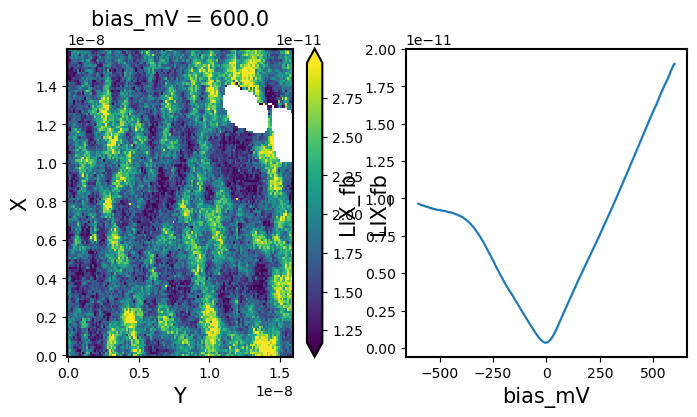

In [35]:
## Lasso not - selected points 
grid_3D_not_slct_pts = grid_3D.where(grid_3D_slct_pts.I_fb.isnull())
#grid_3D_not_slct_pts

fig, axs = plt.subplots(ncols = 2, nrows = 1, figsize = (8,4))

grid_3D_not_slct_pts.LIX_fb.isel(bias_mV= 0).plot(ax = axs[0], robust = True) 

sns.lineplot(x = "bias_mV",            
             y = "LIX_fb", 
             data = grid_3D_not_slct_pts.to_dataframe(),
             ax = axs[1])
plt.show
#grid_3D_slct_pts
#

#### collect selected points and not selected points 



In [36]:
grid_3D_slct_pts_df = grid_3D_slct_pts.LIX_fb.to_dataframe()
grid_3D_not_slct_pts_df = grid_3D_not_slct_pts.LIX_fb.to_dataframe()

#grid_3D_not_slct_pts_df

In [37]:
grid_3D_slct_pts_df.rename(columns = {"LIX_fb" : "LIX_large_defect"})
grid_3D_not_slct_pts_df.rename(columns = {"LIX_fb" : "LIX_avg"})

LIX_avg
Y            X            bias_mV                  
0.000000e+00 0.000000e+00  600.000024  1.383362e-11
                           595.312524  1.252728e-11
                           590.625023  1.660327e-11
                           585.937523  1.702052e-11
                           581.250023  1.637268e-11
...                                             ...
1.586667e-08 1.586667e-08 -581.250023  1.080501e-11
                          -585.937523  9.866994e-12
                          -590.625023  9.334665e-12
                          -595.312524  9.674973e-12
                          -600.000024  1.045645e-11

[3700800 rows x 1 columns]

In [38]:
grid_3D_avg = pd.concat ([grid_3D_slct_pts_df.rename(columns = {"LIX_fb" : "LIX_large_defect"}),
                          grid_3D_not_slct_pts_df.rename(columns = {"LIX_fb" : "LIX_avg"})], axis=1 )

In [46]:
grid_3D_avg_mean = grid_3D_avg.groupby('bias_mV').mean()
grid_3D_avg_std = grid_3D_avg.groupby('bias_mV').std()
grid_3D_avg_mean

,LIX_large_defect,LIX_avg
bias_mV,,
-600.000024,9.663367e-12,9.655238e-12
-595.312524,9.619308e-12,9.636507e-12
-590.625023,9.592162e-12,9.594228e-12
-585.937523,9.551095e-12,9.549087e-12
-581.250023,9.589923e-12,9.546908e-12
...,...,...
581.250023,1.860139e-11,1.850583e-11
585.937523,1.866922e-11,1.865034e-11
590.625023,1.887214e-11,1.880147e-11


In [59]:
grid_3D_avg_mean.index

Float64Index([-600.0000238418579, -595.3125236555934, -590.6250234693289,
              -585.9375232830644, -581.2500230967999, -576.5625229105353,
              -571.8750227242708, -567.1875225380063, -562.5000223517418,
              -557.8125221654773,
              ...
               557.8125221654773,  562.5000223517418,  567.1875225380063,
               571.8750227242708,  576.5625229105353,  581.2500230967999,
               585.9375232830644,  590.6250234693289,  595.3125236555934,
               600.0000238418579],
             dtype='float64', name='bias_mV', length=257)

#### use matplotlib to show fillbetween 

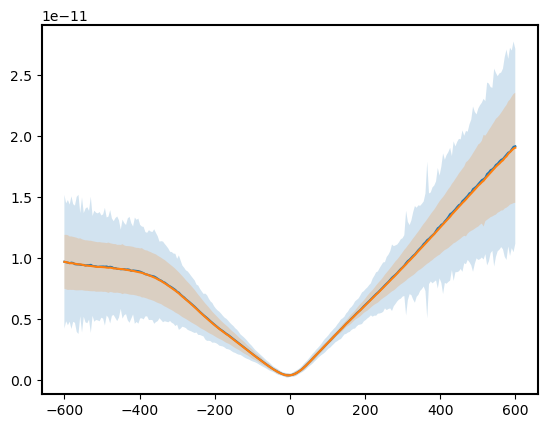

In [62]:
fig, ax = plt.subplots()
ax.plot( grid_3D_avg_mean.LIX_large_defect)
ax.plot( grid_3D_avg_mean.LIX_avg)
#plt.show()
ax.fill_between(grid_3D_avg_mean.index,grid_3D_avg_mean.LIX_large_defect - grid_3D_avg_std.LIX_large_defect, grid_3D_avg_mean.LIX_large_defect + grid_3D_avg_std.LIX_large_defect, alpha=0.2)
ax.fill_between(grid_3D_avg_mean.index,grid_3D_avg_mean.LIX_avg - grid_3D_avg_std.LIX_avg, grid_3D_avg_mean.LIX_avg + grid_3D_avg_std.LIX_avg, alpha=0.2)
#ax.plot(x, y, 'o', color='tab:brown')

In [63]:
grid_3D_avg_df =  grid_3D_avg.unstack().melt().set_index('bias_mV')
grid_3D_avg_df.columns = ['Type', 'LIX']
grid_3D_avg_df

,Type,LIX
bias_mV,,
600.000024,LIX_large_defect,1.383362e-11
600.000024,LIX_large_defect,1.852962e-11
600.000024,LIX_large_defect,1.808321e-11
600.000024,LIX_large_defect,1.718913e-11
600.000024,LIX_large_defect,1.816607e-11
...,...,...
-600.000024,LIX_avg,9.805586e-12
-600.000024,LIX_avg,7.497767e-12
-600.000024,LIX_avg,9.192203e-12


#### use sns to compare two area 

<Axes: xlabel='bias_mV', ylabel='LIX_avg'>

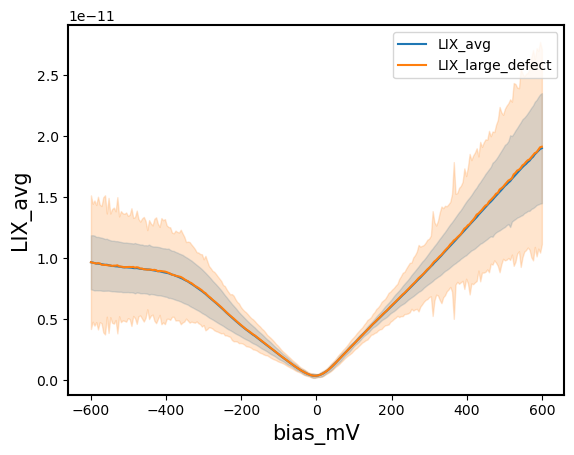

In [68]:
#sns.lineplot(data = grid_3D_avg_df, x = "bias_mV", y = "LIX",hue = "Type", errorbar =("sd"))
sns.lineplot(data = grid_3D_avg, x = "bias_mV", y = "LIX_avg", errorbar =("sd"), label = "LIX_avg")
sns.lineplot(data = grid_3D_avg, x = "bias_mV", y = "LIX_large_defect", errorbar =("sd"), label = "LIX_large_defect")

### Use the topography map for threshold



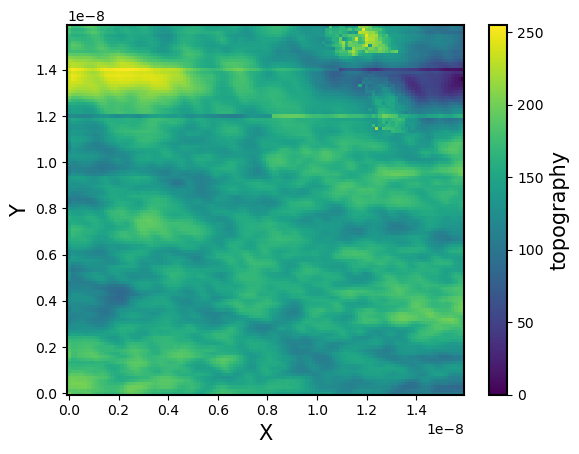

In [70]:
grid_xr_gs = grid_xr
plane_fit_y_xr(grid_xr).topography 

grid_xr_gs.topography.values = plane_fit_y_xr(grid_xr).topography 
grid_xr_gs = filter_convert2grayscale(grid_xr_gs)
topograph_gs = grid_xr_gs.topography

topograph_gs.plot()

#### check the histogram + Otsu thresholds


In [108]:
#grid_xr.topography.plot.hist()
#threshold_otsu_xr(grid_xr.topography).plot()

threshold_otsu_xr(grid_xr_gs).topography.plot()
topo_mask = threshold_otsu_xr(grid_xr_gs).topography.isnull()

#######################
# topo_mask 
# mask with xr format 
#######################

In [113]:
####################
# topo masking 
#
# topo  T&F  
grid_xr.topography.where(~topo_mask).plot()
###############################

<Axes: xlabel='bias_mV', ylabel='LIX_fb'>

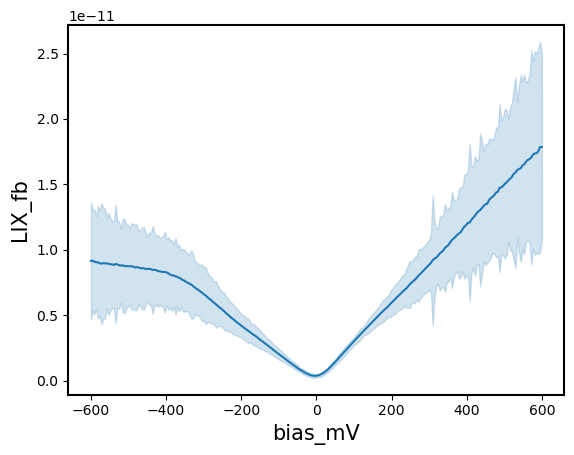

In [116]:
###############################
#  
#  topo masking for LIX_fb
#
#################################

grid_xr.LIX_fb.where(~topo_mask)
filtere_df  = grid_xr.LIX_fb.where(~topo_mask).to_dataframe()

# standard deviation 
sns.lineplot(data = filtere_df, x = "bias_mV", y = "LIX_fb", errorbar =("sd"))


## confidential interval 
#sns.lineplot(data = filtere_df, x = "bias_mV", y = "LIX_fb", errorbar =("ci"))


## percentile interval (50%)
#sns.lineplot(data = filtere_df, x = "bias_mV", y = "LIX_fb", errorbar =("pi"))


### Masking with LDOS 
* use the sel(bias_mV=-300,method="nearest")
* use the bbox xr 


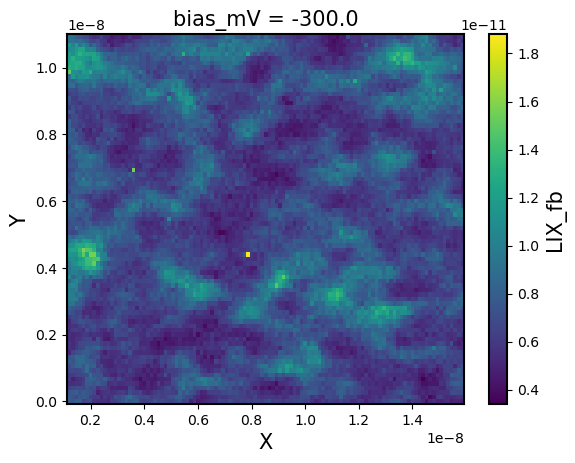

In [195]:
# Test grid slicing use sel 

grid_3D_bbox.LIX_fb.sel(bias_mV=-300,method="nearest").plot()

#### Use the grayscale - threshold - slicing 


<xarray.DataArray 'LIX_unit_calc' (Y: 83, X: 111)>
array([[False,  True, False, ...,  True,  True,  True],
       [False,  True,  True, ...,  True,  True,  True],
       [ True, False, False, ...,  True,  True,  True],
       ...,
       [False, False, False, ...,  True,  True,  True],
       [False, False, False, ...,  True,  True,  True],
       [False, False, False, ...,  True,  True,  True]])
Coordinates:
  * X        (X) float64 1.2e-09 1.333e-09 1.467e-09 ... 1.573e-08 1.587e-08
  * Y        (Y) float64 0.0 1.333e-10 2.667e-10 ... 1.08e-08 1.093e-08
    bias_mV  float64 -300.0

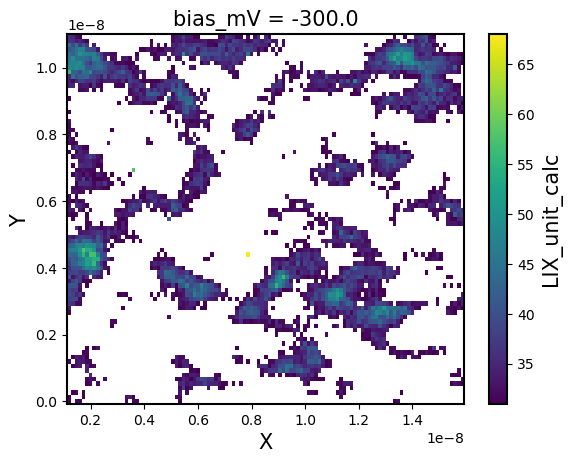

In [204]:
LDOS_mask  = threshold_mean_xr(filter_convert2grayscale(grid_3D_bbox)).LIX_unit_calc.sel(bias_mV=-300,method="nearest")

LDOS_mask.plot()

# LDOS_mask.isnull()

# LDOS_mask.notnull()

In [213]:
# masking with LDOS mask 
grid_3D_bbox.where(LDOS_mask.isnull())

filtered_LDOS300mV_null_df = grid_xr.LIX_fb.where(LDOS_mask.isnull()).to_dataframe()
filtered_LDOS300mV_notnull_df = grid_xr.LIX_fb.where(LDOS_mask.notnull()).to_dataframe()

filtered_LDOS300mV_df = pd.concat ([filtered_LDOS300mV_null_df,filtered_LDOS300mV_notnull_df], axis = 1)
filtered_LDOS300mV_df.columns=["null","notnull"]

filtered_LDOS300mV_df

null       notnull
Y            X            bias_mV                                
0.000000e+00 1.200000e-09  600.000024           NaN  2.139074e-11
                           595.312524           NaN  1.833739e-11
                           590.625023           NaN  2.016926e-11
                           585.937523           NaN  2.038527e-11
                           581.250023           NaN  1.906249e-11
...                                             ...           ...
1.093333e-08 1.586667e-08 -581.250023  7.663505e-12           NaN
                          -585.937523  7.424999e-12           NaN
                          -590.625023  7.364160e-12           NaN
                          -595.312524  6.730001e-12           NaN
                          -600.000024  5.664416e-12           NaN

[2367741 rows x 2 columns]

<Axes: xlabel='bias_mV', ylabel='null'>

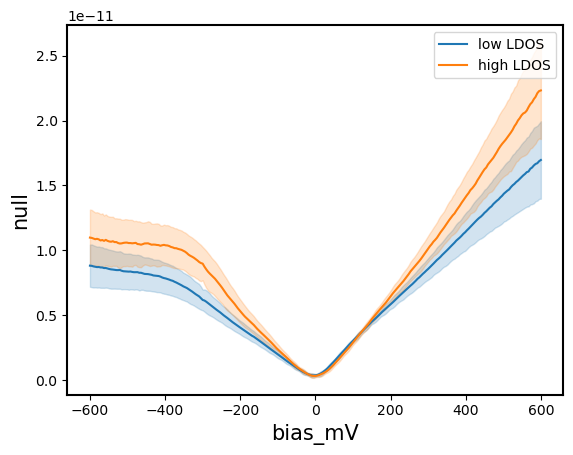

In [215]:
# standard deviation 
sns.lineplot(data = filtered_LDOS300mV_df, x = "bias_mV", y = "null", errorbar =("sd"), label = 'low LDOS')
sns.lineplot(data = filtered_LDOS300mV_df, x = "bias_mV", y = "notnull", errorbar =("sd"), label = 'high LDOS')

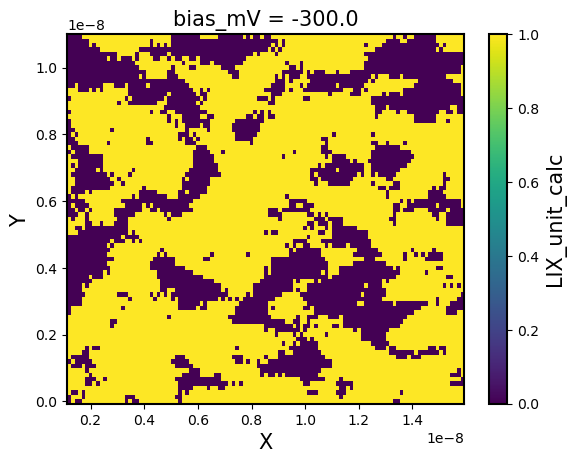

In [227]:
LDOS_mask.isnull().plot()